## 0. Downloading the datasets

Create a "data" folder for the datasets and a "templates" for the plots we are going to create.

Do not forget to download and unzip:
+ The Bike Lanes in San Francisco dataset from [DataSF](https://data.sfgov.org/Transportation/SFMTA-Bikeway-Network/ygmz-vaxd).
+ The Streets in San Francisco dataset from [Data.gov](https://catalog.data.gov/dataset/tiger-line-shapefile-2017-county-san-francisco-county-ca-all-roads-county-based-shapefile)

Instead of doing all this, you can run `upload_dataset`, a code doing all of that for you.

In [14]:
import upload_dataset

Bike Network Db file already downloaded
Streets SF Db file already downloaded


## 1. How to plot shapefile databases (.shp) using GeoPandas?

In [1]:
#Uploading the shapefiles
import geopandas as gpd

db_bike_path="data/geo_export_0ff3043a-1833-476b-afe0-779dfa091ebd.shp"
db_bike=gpd.read_file(db_bike_path)

db_roads_path="data/tl_2017_06075_roads.shp"
db_roads=gpd.read_file(db_roads_path)

db_bike.columns,db_roads.columns

(Index(['barrier', 'biap', 'buffered', 'cnn', 'contraflow', 'created_da',
        'created_us', 'dir', 'direct', 'double', 'facility_t', 'from_st', 'fy',
        'globalid', 'greenwave', 'install_mo', 'install_yr', 'last_edite',
        'length', 'notes', 'number_', 'qtr', 'raised', 'sharrow', 'sm_sweeper',
        'street_', 'streetname', 'surface_tr', 'symbology', 'to_st',
        'update_mo', 'update_yr', 'geometry'],
       dtype='object'),
 Index(['LINEARID', 'FULLNAME', 'RTTYP', 'MTFCC', 'geometry'], dtype='object'))

`read_file` reads any .shp file without any problem. The column having the geospatial information needs to be called `geometry`. Thic convention is respected but remember to check it if you get an error message stating that the column `geometry` is missing. 

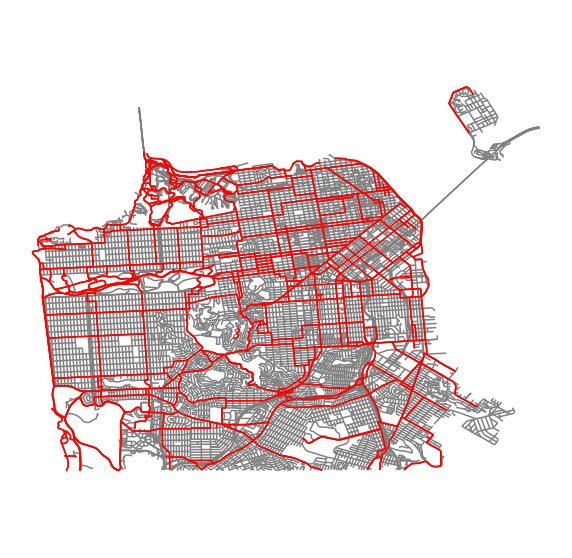

In [13]:
#Plotting the databases
import matplotlib.pyplot as plt

fig, ax = plt.subplots(1, 1,figsize=(10,10))

db_roads.plot(ax=ax,color="gray")
db_bike.plot(ax=ax,color="red")

plt.axis('equal')
plt.axis('off')
plt.show()

As you can see, a few lines of code are enough to read and plot a shapefile database without breaking any sweat. The rest is just knowing how to use Matplotlib.

Now let’s consider you want the user being able to zoom the graph or to hide/show the "Bike Lanes" at any time. In that case, GeoPandas will not be enough as you can only create static plot with it. Don’t worry, there is an alternative. Let’s use Bokeh!

## How to make an interactive plot using Bokeh?

Bokeh is a very interesting Python library you can do a lot of stuff with. I advise to take a look at [Bokeh's gallery](http://docs.bokeh.org/en/1.3.2/docs/gallery.html) and look at all their fancy examples. Bokeh advantages are:

+ handling the JavaScript part of the plot that makes it interactive with some lines of code in Python
+ connecting sliders, buttons, and many others objects that can change your plot when the user plays with them
+ beautiful default design settings

First, let’s plot with Bokeh the same plot as before.

To do so, we first need to know what kind of spatial element we are plotting. 
+ `Point`(or `Multi-Points`) can be plotted with `.circle`
+ `Line`(or `Multi-Lines`) can be plotted with `.multi_line`
+ `Polygon`(or `Multi-Polygons`) can be plotted with `.patch`

As it can be seen bellow, in the two databases, we are working with `Line`(or `Multi-Lines`). Therefore, we will be using `.multi_line` to plot our database. For more details, the best is to look at the tutorial made on the plotting topic by [Bokeh](https://docs.bokeh.org/en/latest/docs/reference/plotting.html) and/or by [GeoPandas](https://automating-gis-processes.github.io/2016/Lesson5-interactive-map-bokeh.html)

In [3]:
db_bike.geometry.type.unique(),db_roads.geometry.type.unique()

(array(['LineString'], dtype=object), array(['LineString'], dtype=object))

In [4]:
#Libraries for Dynamic Vizualisation
from bokeh.plotting import figure
from bokeh.io import output_file,show,output_notebook
from bokeh.models import GeoJSONDataSource

#To display in the notebook your Bokeh Plot
output_notebook()

#SF, San Francisco, will be the figure containing the plots.
SF = figure(aspect_scale=1, match_aspect=True,sizing_mode='scale_height')

#Bokeh can only plot json db
#GeoJSONDataSource tsakes care of the conversion
db_roads_json=GeoJSONDataSource(geojson = db_roads.to_json())
multi_line_all=SF.multi_line('xs', 'ys', source=db_roads_json,
    color="gray", line_width=0.5,legend="All streets")

db_bike_json=GeoJSONDataSource(geojson = db_bike.to_json())
multi_line_bike=SF.multi_line('xs', 'ys', source=db_bike_json,
    color="red", line_width=1.5,legend="Bike Lanes")

#Hide axis and grid
SF.axis.visible=False
SF.xgrid.visible = False
SF.ygrid.visible = False

show(SF)
#enables you to save a stand alone plot as a html page
output_file("templates/SF_plot.html")

Loading BokehJS ...

As you can see, we have recreated the same plot as the one done with GeoPandas and Matplotlib. We have actually a bit cheated. You can see, in the top right, icons. Those icons are coming by default with your Bokeh plot and can be removed. Each icon has a built-in function associated. E.g. The second and third one from the top are for different kinds of zooms.You can only use an icon at a time. Try them out !

Let's now create two checkboxes with `CheckboxGroup`. One for "Bike Lanes" and one for "All strets". We want them to hide/show the associated curve when the user click on them.

In [5]:
from bokeh.models.widgets import CheckboxGroup
from bokeh.layouts import  row

checkbox_choices = CheckboxGroup(labels=["All streets", "Bike Lanes"], 
    active=[i for i in range(2)])

layout=row(SF,checkbox_choices)

show(layout)
output_file("templates/SF_plot_widgets.html")

The checkboxes are currently standing alone and clicking on them will do nothing. Try it !

You could connect the checkboxes with a code in Python and Bokeh would take care of the conversion of this code into JavaScript. That sounds perfect. Unfortunately, this conversion requires having a Bokeh server running alongside your plot which is everything but convenient. Do not worry, Bokeh developers are really smart and they allow you to put in your code pieces of JavaScript that will take care of the connection between the checkboxes and the plot. This is what we are going to do. As a non JavaScript lover, I can promise you that the JS part will be very small and simple. However your JS code will depend of your project and the number of widgets you want to connect to your plot.

Creating the plot ineractivity requires:
+ a dictionary with all the elements included in the interactivity. Here it will be our two `multi_line` and our checkboxes. 
+ a JS code monitoring the interactivity. Whenever you call the elements in the interactivity use the same names as the one given in the dictionary
+ make a callback on the objects that will be clicked by the user with the dictionnary and the JS code.

In [6]:
from bokeh.models import CustomJS

update_elements=dict(curves=[multi_line_all,multi_line_bike],
    check=checkbox_choices)

updatingJS="""
    var coefs=check.active;
    
    for (var i = 0; i<= coefs.length; i++){
        console.log(coefs.includes(i))
        if (coefs.includes(i)){
            curves[i].visible=true;
        }
        else{
            curves[i].visible=false;
        }
    }    
"""
checkbox_choices.callback=CustomJS(args=update_elements,code=updatingJS)

layout=row(SF,checkbox_choices)

show(layout)
output_file("templates/SF_plot_widgets_connected.html")

Here we are. We have a dynamic plot. The user can decide what plot to see and can also zoom to some specific neighbor of San Francsico.

These checkboxes were actually an excuse to show you how everything works for your own project. In case you are interested into hiding/showing a plot at will, Bokeh already has a function in Python that can do this. Thank you Bokeh ! You can find the code for our example below. Click on `bikeways` or `streets` in the legend to hide/show the associated plot in the figure.

In [7]:
#Libraries for Dynamic Vizualisation
from bokeh.plotting import figure
from bokeh.io import output_file,show
from bokeh.models import GeoJSONDataSource


SF = figure(aspect_scale=1, match_aspect=True,sizing_mode='scale_height')

db_roads_json=GeoJSONDataSource(geojson = db_roads.to_json())
multi_line_all=SF.multi_line('xs', 'ys', source=db_roads_json,
    color="gray", line_width=0.5,legend="All streets")

db_bike_json=GeoJSONDataSource(geojson = db_bike.to_json())
multi_line_bike=SF.multi_line('xs', 'ys', source=db_bike_json,
    color="red", line_width=1.5,legend="Bike Lanes")

SF.legend.click_policy="hide"

#Hide axis and grid
SF.axis.visible=False
SF.xgrid.visible = False
SF.ygrid.visible = False

show(SF)
output_file("templates/SF_plot_legend.html")

Now that are in possession of this interactive plot, let’s make it available to the users in a website.

Go back to the [tutorial webpage](https://yannfra.github.io/Creating-Website-Flask-Bokeh-GeoPandas/) to see how to do this.